# Importy

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import networkx as nx

# Do wizualizacji

In [2]:
def bias_to_color(bias, vmin, vmax):
    """Funkcja pomocniczna do liczenia koloru node"""

    if vmin < 0 and vmax > 0:
        # Przypadek 1: mamy biasy ujemne i dodatnie, wówczas używamy red yellow green color mapy
        norm = mcolors.TwoSlopeNorm(vmin=vmin, vcenter=0, vmax=vmax)
        cmap = plt.get_cmap("RdYlGn") 
    elif vmin >= 0:
        # Przypadek 2: Wszystkie biasy >= 0, wówczas używamy yellow green color mapy
        norm = mcolors.Normalize(vmin=vmin, vmax=vmax)
        cmap = plt.get_cmap("YlGn")
    else:
        # Przypadek 3: Wszystkie biasy <= 0, wówczas używamy yellow orange red mapy (reversed, bo jest od yellow do red, a chcemy, żeby vmax był yellow dla ujemnych)
        norm = mcolors.Normalize(vmin=vmin, vmax=vmax)
        cmap = plt.get_cmap("YlOrRd_r")

    return cmap(norm(bias))

def draw_network_networkx(mlp):
    """Wizualizuje stan wag i biasów w sieci:
        - kolor neuronu zależy od wartości biasu (w danej wartwie)
        - kolor krawędzi zależy od znaku odpowiadającej wagi
        - grubość krawędzi zależy od wartości odpowiadającej wagi (tylko dana warstwa)
    """
    G = nx.DiGraph()

    # Zczytaj ilość neuronów
    layers_sizes = []
    input_size = mlp.layers[0].weights.shape[0]
    layers_sizes.append(input_size)
    for layer in mlp.layers:
        layers_sizes.append(layer.weights.shape[1])
    n_layers = len(layers_sizes)

    # Ustal pozycje
    pos = {}
    node_colors = {}
    h_spacing = 2.0  # Odległość horyzontalna między warstwami
    v_spacing = 1.5  # Odległość wertykalna między neuronami tej samej warstwy

    # Ustalamy pozycje i color neuronów
    for i, n_neurons in enumerate(layers_sizes): # dla i-tej warstwy
        x = i * h_spacing
        # Neurony oddzielamy równomiernie w warstwie
        if n_neurons > 1:
            y_positions = np.linspace(0, (n_neurons - 1) * v_spacing, n_neurons)
            y_positions = y_positions - np.max(y_positions) / 2
        else:
            y_positions = np.array([0])
        
        for j, y in enumerate(y_positions): # dla j-tego neuronu w i-tej warstwie
            node_id = (i, j)
            pos[node_id] = (x, y) # ustalamy pozycje neuronu
            if i == 0:
                # Dla input layer ustawiamy kolor neutralny
                node_colors[node_id] = 'lightblue'
            else: # Dla innej niż input layer
                bias = mlp.layers[i-1].biases[j]
                biases_layer = mlp.layers[i-1].biases
                # Normalizujemy kolor funkcją pomociczą
                if len(biases_layer) > 1: # Jeśli mamy > jeden neuron w wartstwie
                    vmin, vmax = np.min(biases_layer), np.max(biases_layer)
                    node_colors[node_id] = bias_to_color(bias, vmin, vmax)
                else: # Jeśli jest jeden nauron
                    node_colors[node_id] = "red" if bias < 0 else "green"
                    
            G.add_node(node_id)

    # Ustalamy grubość połączeń między neuronami na podstawie wag
    for i, layer in enumerate(mlp.layers): # DLa i-tej wastwy
        weights = layer.weights  # połączenie i-tej oraz (i+1)-tej warstwy
        max_weight = np.max(np.abs(weights))
        # Unkamy dzielenia przez 0
        if max_weight == 0:
            max_weight = 1
        for j in range(weights.shape[0]): # DLa j-tego neuronu z i-tej warstwy
            for k in range(weights.shape[1]): # Dla k-tego neurony z (i+1)-tej warstwy
                source = (i, j) # Od j tego neuronu z i-tej warstwy
                target = (i+1, k) # Do k-tego z i+1
                weight = weights[j, k]
                # Skalujemy grubość połączenia (w danej warstwie)
                lw = 0.5 + 5 * (abs(weight) / max_weight)
                color = "red" if weight < 0 else "green"
                G.add_edge(source, target, weight=weight, width=lw, color = color)

    # Rysujemy graf
    fig, ax = plt.subplots(figsize=(12, 8))
    # Rysujemy neurony z kolorami
    node_color_list = [node_colors[node] for node in G.nodes()]
    nx.draw_networkx_nodes(G, pos, node_color=node_color_list, node_size=800, ax=ax)
    
    # Rysujemy połączenia z grubością i kolorami
    edge_widths = [d['width'] for (_, _, d) in G.edges(data=True)]
    edge_colors = [d['color'] for (_, _, d) in G.edges(data=True)]
    nx.draw_networkx_edges(G, pos, ax=ax, width=edge_widths, edge_color=edge_colors)
    
    # Labelujemy neurony za pomocą indexu w warstwie
    labels = {node: f"{node[1]}" for node in G.nodes()}
    nx.draw_networkx_labels(G, pos, labels, font_size=10, ax=ax)

    ax.set_title("Neural Net Visualization")
    ax.axis('off')
    plt.show()

def show_loss(epoch_arr, loss_arr):
    plt.figure(figsize = (12, 8))
    plt.plot(epoch_arr, loss_arr)
    plt.title("Loss vs epochs")
    plt.xlabel("Epoch")
    plt.ylabel("Loss")
    plt.show()

def eval_2d(network, x, y):
    y_pred = network.predict(x)
    plt.scatter(x, y, s = 1, label = "True")
    plt.scatter(x, y_pred, s=1, label = "Predicted")
    plt.title(f"How fun is fitting desired y")
    plt.legend()
    plt.show()

# Definicja sieci

Zmiany:
- dodana możliwość ustawienia Dropout
- dodana możliwość wcześniejszego stopu
- wyrzucenie funkcji train_to_visualize, bo niepotrzeba jest (przerzucam funkcjonalność do po prost train)
- dodanie l1 i l2 regularyzacji (jednak używam dopiero od Testy2 w multimodal-sparse)

In [3]:
class Optimizer:
    def update(self, layer, dW, db):
        raise NotImplementedError("This method should be overridden")

class SGD(Optimizer):
    def __init__(self, lr=0.05):
        self.lr = lr

    def update(self, layer, dW, db):
        layer.weights -= self.lr * dW
        layer.biases  -= self.lr * db

class Momentum(Optimizer):
    def __init__(self, lr=0.05, lamb=0.9):
        self.lr = lr
        self.lamb = lamb
        self.momentum = {}

    def update(self, layer, dW, db):
        # Inicjujemy momentum
        if layer not in self.momentum:
            self.momentum[layer] = {'dW': np.zeros_like(dW), 'db': np.zeros_like(db)}

        ## Version 1
        # # Update sredniej
        # self.momentum[layer]['dW'] = self.lamb * self.momentum[layer]['dW'] - self.lr * dW
        # self.momentum[layer]['db'] = self.lamb * self.momentum[layer]['db'] - self.lr * db
        # # Update parametrow
        # layer.weights += self.momentum[layer]['dW']
        # layer.biases  += self.momentum[layer]['db']
        
        ## Version 2
        # Update momentum
        self.momentum[layer]['dW'] = self.lamb * self.momentum[layer]['dW'] - dW
        self.momentum[layer]['db'] = self.lamb * self.momentum[layer]['db'] - db
        
        # Update parameters using the momentum
        layer.weights += self.lr * self.momentum[layer]['dW']
        layer.biases  += self.lr * self.momentum[layer]['db']

class RMSProp(Optimizer):
    def __init__(self, lr=0.05, beta = 0.9):
        self.lr = lr
        self.beta = beta
        self.mean_sq_grad = {}
    
    def update(self, layer, dW, db):
        # Inicjujemy
        if layer not in self.mean_sq_grad:
            self.mean_sq_grad[layer] = {'dW': np.zeros_like(dW), 'db': np.zeros_like(db)}
        # Update sredniej
        self.mean_sq_grad[layer]['dW'] = self.beta * self.mean_sq_grad[layer]['dW'] + (1 - self.beta) * dW ** 2
        self.mean_sq_grad[layer]['db'] = self.beta * self.mean_sq_grad[layer]['db'] + (1 - self.beta) * db ** 2

        # Update parametrow
        layer.weights -= self.lr * dW / np.sqrt(self.mean_sq_grad[layer]['dW'] + np.finfo(float).eps)
        layer.biases  -= self.lr * db / np.sqrt(self.mean_sq_grad[layer]['db'] + np.finfo(float).eps)

class Adam(Optimizer):
    def __init__(self, lr=0.01, beta1 = 0.9, beta2 = 0.999, epsilon = np.finfo(float).eps):
        self.lr = lr
        self.beta1 = beta1
        self.beta2 = beta2
        self.m = {}
        self.v = {}
        self.t = {}
        self.epsilon = epsilon
        
    def update(self, layer, dW, db):
        # Inicjujemy
        if layer not in self.m:
            self.m[layer] = {'dW': np.zeros_like(dW), 'db': np.zeros_like(db)}
            self.v[layer] = {'dW': np.zeros_like(dW), 'db': np.zeros_like(db)}
            self.t[layer] = 0

        # Set t
        self.t[layer] += 1
        
        # Update weights
        self.m[layer]["dW"] = self.beta1 * self.m[layer]["dW"] + (1 - self.beta1) * dW
        self.v[layer]["dW"] = self.beta2 * self.v[layer]["dW"] + (1 - self.beta2) * dW**2
        m_hat = self.m[layer]["dW"] / (1 - self.beta1**self.t[layer])
        v_hat = self.v[layer]["dW"] / (1 - self.beta2**self.t[layer])
        layer.weights -= self.lr * m_hat / (np.sqrt(v_hat) + self.epsilon)

        # Update bias
        self.m[layer]["db"] = self.beta1 * self.m[layer]["db"] + (1 - self.beta1) * db
        self.v[layer]["db"] = self.beta2 * self.v[layer]["db"] + (1 - self.beta2) * db**2
        m_hat = self.m[layer]["db"] / (1 - self.beta1**self.t[layer])
        v_hat = self.v[layer]["db"] / (1 - self.beta2**self.t[layer])
        layer.biases -= self.lr * m_hat / (np.sqrt(v_hat) + self.epsilon)

In [4]:
def sigmoid(x):
    return 1 / (1 + np.exp(-x))
def sigmoid_deriv(output):
    # Zakłada, że wejściem jest "a", a nie "z" (czyli, że jest to już po zastosowaniu sigmoid(a))
    return output * (1 - output)
def linear(x):
    return x
def linear_deriv(x):
    return 1.0
def softmax(z):
    d = -np.max(z, axis=1, keepdims=True)
    return np.exp(z + d) / np.sum(np.exp(z + d), axis=1, keepdims=True)
    
def mse(y_true, y_pred):
    return np.mean((y_true - y_pred)**2)
def cross_entropy(y_true, y_pred):
    epsilon = 1e-12
    return -np.mean(np.sum(y_true*np.log(y_pred + epsilon), axis=1))
def cross_entropy_from_logits(y_true, logits):
    y_pred = softmax(logits)    
    return cross_entropy(y_true, y_pred)
def one_hot(x):
    result = np.int64(np.zeros((x.size, x.max() + 1)))
    result[np.arange(x.size), x] = 1
    return result
def one_hot_from_probabilities(y_pred):
    return one_hot(y_pred.argmax(axis=1))
def from_one_hot_to_label(x):
    return x.argmax(axis=1)
def f1_score(y_true, y_pred): # Zakładamy, że są to predykcje trybie "labelled", czyli wektor [0, 1, 2, 1, ..]
    classes = np.unique(np.concatenate((y_true, y_pred)))
    f1_arr = []
    for cls in classes:
        tp = np.sum((y_true == cls) & (y_pred == cls))
        fp = np.sum((y_true != cls) & (y_pred == cls))
        fn = np.sum((y_true == cls) & (y_pred != cls))
        if tp == 0:
            f1 = 0.0
        else:
            precision = tp / (tp + fp)
            recall = tp / (tp + fn)
            f1 = 2 * precision * recall / (precision + recall)
        f1_arr.append(f1)
    return np.mean(f1_arr)

# Nowe funkcje aktywacji
def tanh(x):
    return np.tanh(x)

def tanh_deriv(output):
    # Zakłada, że wejściem jest "a", a nie "z" (czyli, że jest to już po zastosowaniu tanh(a))
    return 1 - np.power(output, 2)

def relu(x):
    return np.maximum(0, x)

def relu_deriv(a_out):
    # Zakłada, że wejściem jest "a", a nie "z" (czyli, że jest to już po zastosowaniu relu(a))
    return np.where(a_out > 0, 1.0, 0.0)

def leaky_relu(x, alpha=0.01):
    return np.where(x > 0, x, alpha * x)

def leaky_relu_deriv(a_out, alpha=0.01):
    # Zakłada, że wejściem jest "a", a nie "z" (czyli, że jest to już po zastosowaniu leaky_relu(a))
    return np.where(a_out > 0, 1.0, alpha)
    

class Layer: # Warstwa sieci
    def __init__(self, input_size, output_size, act_fun, act_derivative, init_type = 'random', dropout_rate=0.0):
        if init_type == "random":
            self.weights = np.random.random((input_size, output_size))
            self.biases = np.random.random(output_size)
        elif init_type == "xavier":
            limit = np.sqrt(2 / (input_size + output_size))
            self.weights = np.random.randn(input_size, output_size) * limit
            self.biases = np.zeros(output_size)
        elif init_type == "he":
            self.weights = np.random.randn(input_size, output_size) * np.sqrt(2 / input_size)
            self.biases = np.zeros(output_size)
        self.act_fun = act_fun
        self.act_derivative = act_derivative
        self.a_in = None
        self.z = None
        self.a_out = None
        self.dropout_rate = dropout_rate  #  (0.0 oznacza brak dropout)
        self.dropout_mask = None

    def forward(self, x, training=False):
        self.a_in = x
        z = np.dot(x, self.weights) + self.biases
        self.z = z
        z = self.act_fun(z)
        self.a_out = z
        # Tylko podczas treningu, kiedy chcemy mieć jakikolwiek dropout
        if training and self.dropout_rate > 0.0:
            self.dropout_mask = (np.random.rand(*self.a_out.shape) > self.dropout_rate) / (1 - self.dropout_rate)
            self.a_out *= self.dropout_mask
        else:
            self.dropout_mask = None
        return z

    def backward(self, dA):
        # IJeśli ustawiony jest dropout to dropout_mask nie jest None i zmieniamy wtedy gradient zgodnie z maską
        if self.dropout_mask is not None:
            dA *= self.dropout_mask
        # dC / dz
        dZ = self.act_derivative(self.a_out) * dA # zakładamy, że używamy act_derivative na "a", a nie na "z". W przypadku ostatniej warstwy nie ma to znaczenia, o ile zakładamy, że wyjście jest funkcją liniową, a zatem ma stałą pochodną
        # Zmiana na wagach (L)
        dW = np.dot(self.a_in.T, dZ)
        # Zmiana na bias (L)
        db = np.sum(dZ, axis=0)
        # Zmiana dA (L-1)
        dA_in = np.dot(dZ, self.weights.T)
        return dA_in, dW, db
    
    def show_params(self):
        print("Weights")
        print(self.weights)
        print("Biases")
        print(self.biases)

class MLP: # Cała sieć
    def __init__(self, neural_arr, act_fun, act_derivative, out_fun, out_derivative, init_type = "random", dropout_rate=0.0):
        self.layers = []
        for i in range(len(neural_arr) - 2):
            self.layers.append(Layer(neural_arr[i], neural_arr[i+1], act_fun, act_derivative, init_type, dropout_rate))  # Dodajemy dropout w wewnętrznych warstwach
        self.layers.append(Layer(neural_arr[-2], neural_arr[-1], out_fun, out_derivative, init_type, dropout_rate=0.0))

        # Do standaryzacji potem
        self.input_mean = None
        self.input_std = None
        self.output_mean = None
        self.output_std = None

    def standarize_input(self, x):
        return (x - self.input_mean) / self.input_std
    def standarize_output(self, y):
        return (y - self.output_mean) / self.output_std
    def destandarize_output(self, y_std):
        return y_std * self.output_std + self.output_mean

    def forward(self, x, training=False): # Dodajemy flagę training
        z = x.copy()
        for i in range(len(self.layers)):
            z = self.layers[i].forward(z, training)
        return z
        
    def predict(self, x):
        x_std = self.standarize_input(x)
        y_std = self.forward(x_std)
        return self.destandarize_output(y_std)

    def backward(self, dA, optimizer, l1_lambda, l2_lambda):
        for layer in reversed(self.layers):
            dA, dW, db = layer.backward(dA)
            dW += l1_lambda * np.sign(layer.weights) + l2_lambda * layer.weights  # DODANIE REGULARYZACJI
            optimizer.update(layer, dW, db)

    def train(self, x, y, epochs = 100, loss_fun = mse, optimizer = None, batch_size = None, early_stopping_patience=0, val_x=None, val_y=None, l1_lambda=0, l2_lambda=0):  # Dodajemy możliwość early_stopu i regularyzacji
        """Batch Gradient Descent by default"""
        # Zapisuje średnie i odchylenia inputu i outputu
        self.input_mean = np.mean(x, axis=0)
        self.input_std = np.std(x, axis=0)
        self.output_mean = np.mean(y, axis=0)
        self.output_std = np.std(y, axis=0)

        # standaryzuje x i y zanim zaczne uczyc
        x_std = self.standarize_input(x)
        y_std = self.standarize_output(y)

        if batch_size == None: # Zapewnia, że jest to batch gradient descent by default
            batch_size = y.shape[0]
        optimizer = optimizer if optimizer is not None else SGD(lr=0.05) # Zapewnia, że istnieje optimizer

        # Do early stopu
        best_val_loss = np.inf
        patience_counter = 0
        
        # Trenujemy
        loss_history = np.zeros(epochs)
        for epoch in range(epochs):
            loss = 0

            if batch_size != 1:
                # tworze batche
                order = np.arange(y.shape[0])
                np.random.shuffle(order)
                batches = np.array_split(order, len(order) // batch_size + (len(order) % batch_size != 0) )
            else: # Znacznie polepsza czas gdy chcemy brac jedna probke na raz (sgd)
                batches = np.arange(y.shape[0]).reshape(-1, 1)
            
            for batch in batches:
                x_tmp = x_std[batch, :]
                y_tmp = y_std[batch, :]
                # Forward
                y_pred_std = self.forward(x_tmp, training=True)
                loss += loss_fun(y_tmp, y_pred_std)
                # Backward
                # Trzeba podzielić jeszcze przez wielkość próby, bo gradient "na raz" chcę się za dużo poprawić / batch_size
                dA = (y_pred_std - y_tmp) / batch_size
                self.backward(dA, optimizer, l1_lambda=l1_lambda, l2_lambda=l2_lambda)

            loss = loss / len(batches)
            loss_history[epoch] = loss
            if epoch % int(epochs / 4) == 0:
                print(f"Epoch: {epoch+1}, Loss (standarized): {loss}")

            # Jeśli podaliśmy dane walidacyje to sprawdzamy (pod early stopping)
            if val_x is not None and val_y is not None and early_stopping_patience!=0:
                x_val_std = self.standarize_input(val_x)
                y_val_std = self.standarize_output(val_y)
                y_val_pred = self.forward(x_val_std, training=False)
                val_loss = loss_fun(y_val_std, y_val_pred)
                if epoch % int(epochs / 4) == 0:
                    print(f"          Validation Loss (standardized): {val_loss}")
                
                # Sprawdzamy czy błąd na walidacyjnych danych się zwiększył
                if val_loss < best_val_loss:
                    best_val_loss = val_loss
                    patience_counter = 0
                else:
                    patience_counter += 1
                    if early_stopping_patience > 0 and patience_counter >= early_stopping_patience:
                        print(f"Early stopping triggered. No improvement in validation loss for {early_stopping_patience} epochs.")
                        break
        
        print(f"Final epoch: {epoch+1}, Final loss (standarized): {loss}")

        return loss_history   

    def train_classify(self, x, y, epochs = 100, loss_fun = cross_entropy, optimizer = None, batch_size = None, early_stopping_patience=0, val_x=None, val_y=None, l1_lambda=0, l2_lambda=0):
        # Zapisuje średnie i odchylenia inputu i outputu
        self.input_mean = np.mean(x, axis=0)
        self.input_std = np.std(x, axis=0)
        self.output_mean = 0
        self.output_std = 1

        # standaryzuje x zanim zaczne uczyc
        x_std = self.standarize_input(x)
        y_std = y

        if batch_size == None: # Zapewnia, że jest to batch gradient descent by default
            batch_size = y.shape[0]
        optimizer = optimizer if optimizer is not None else SGD(lr=0.05) # Zapewnia, że istnieje optimizer

        # Do early stopu
        best_val_loss = np.inf
        patience_counter = 0
        
        # Trenujemy
        loss_history = np.zeros(epochs)
        for epoch in range(epochs):
            loss = 0

            if batch_size != 1:
                # tworze batche
                order = np.arange(y.shape[0])
                np.random.shuffle(order)
                batches = np.array_split(order, len(order) // batch_size + (len(order) % batch_size != 0) )
            else: # Znacznie polepsza czas gdy chcemy brac jedna probke na raz (sgd)
                batches = np.arange(y.shape[0]).reshape(-1, 1)
            
            for batch in batches:
                x_tmp = x_std[batch, :]
                y_tmp = y_std[batch, :]
                # Forward
                y_pred_std = self.forward(x_tmp, training=True)
                loss += loss_fun(y_tmp, y_pred_std)
                # Backward
                # Trzeba podzielić jeszcze przez wielkość próby, bo gradient "na raz" chcę się za dużo poprawić / batch_size
                dA = (y_pred_std - y_tmp) / batch_size
                self.backward(dA, optimizer, l1_lambda=l1_lambda, l2_lambda=l2_lambda)

            loss = loss / len(batches)
            loss_history[epoch] = loss
            if epoch % int(epochs / 4) == 0:
                print(f"Epoch: {epoch+1}, Loss (standarized): {loss}")

            # Jeśli podaliśmy dane walidacyje to sprawdzamy (pod early stopping)
            if val_x is not None and val_y is not None and early_stopping_patience!=0:
                x_val_std = self.standarize_input(val_x)
                y_val_std = self.standarize_output(val_y)
                y_val_pred = self.forward(x_val_std, training=False)
                val_loss = loss_fun(y_val_std, y_val_pred)

                if epoch % int(epochs / 4) == 0:
                    print(f"          Validation Loss (standardized): {val_loss}")
                
                # Sprawdzamy czy błąd na walidacyjnych danych się zwiększył
                if val_loss < best_val_loss:
                    best_val_loss = val_loss
                    patience_counter = 0
                else:
                    patience_counter += 1
                    if early_stopping_patience > 0 and patience_counter >= early_stopping_patience:
                        print(f"Early stopping triggered. No improvement in validation loss for {early_stopping_patience} epochs.")
        
        print(f"Final epoch: {epoch+1}, Final loss (standarized): {loss}")
        return loss_history

    def show_params(self):
        for i in range(len(self.layers)):
            print("Layer: ", i)
            self.layers[i].show_params()
            print("")

# Content

## Dane multimodal sparse

### Pobranie

In [5]:
# Pobieramy dane
data_train = pd.read_csv("../Data/regression/multimodal-sparse-training.csv").to_numpy()
x_train = data_train[:, 0].reshape(-1, 1)
y_train = data_train[:, 1].reshape(-1, 1)

data_test = pd.read_csv("../Data/regression/multimodal-sparse-test.csv").to_numpy()
x_test = data_test[:, 0].reshape(-1, 1)
y_test = data_test[:, 1].reshape(-1, 1)

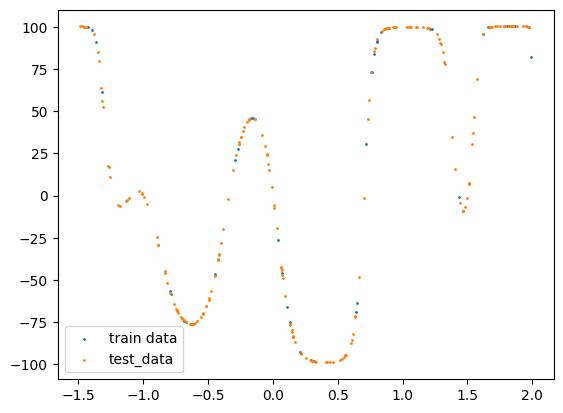

In [6]:
plt.scatter(x_train, y_train, s = 1, label = "train data")
plt.scatter(x_test, y_test, s = 1, label = "test_data")
plt.legend()
plt.show()

### Testy

In [7]:
np.random.seed(123)
archs = [[1, 20, 20, 1]]
funs = [sigmoid, tanh, relu, leaky_relu]  # Testy pokazują, że leaky_relu tutaj średnio sobie radził, więc usunąłem, żeby lepiej działało
fun_derivs = [sigmoid_deriv, tanh_deriv, relu_deriv, leaky_relu_deriv]
dropouts = [0, 0.1, 0.3, 0.5]
early_stops = [0, 10, 20, 50, 100, 200, 500]  # Patience = 1 jest za mały tak samo = 5, więc usunąłem
initialization = ["xavier", "xavier", "he", "he"]
results = { "Arch": [],
            "Fun": [],
            "Test_loss": [],
            "Train_results": [], 
            "Dropout": [],
            "Patience": [],
            "Net": []}

for arch in archs:
    for i in range(len(funs)):
        for dropout in dropouts:
            for early_stop in early_stops:
                net = MLP(arch, act_fun=funs[i], act_derivative=fun_derivs[i], out_fun=linear, out_derivative=linear_deriv, init_type=initialization[i], dropout_rate=dropout)
                curr_result = net.train(x = x_train, y = y_train, epochs = 5000, optimizer=Adam(), batch_size=10, early_stopping_patience=early_stop, val_x=x_test, val_y=y_test)
                y_pred = net.predict(x_test)
                test_loss = mse(y_pred, y_test)
                results["Arch"].append(arch)
                results["Fun"].append(funs[i])
                results["Test_loss"].append(test_loss)
                results["Train_results"].append(curr_result)
                results["Dropout"].append(dropout)
                results["Patience"].append(early_stop)
                results["Net"].append(net)

Epoch: 1, Loss (standarized): 1.063931000001304
Epoch: 1251, Loss (standarized): 0.042236271091842865
Epoch: 2501, Loss (standarized): 0.03496096230863868
Epoch: 3751, Loss (standarized): 0.007622001954548806
Final epoch: 5000, Final loss (standarized): 0.0015965367295896463
Epoch: 1, Loss (standarized): 1.111564432619397
          Validation Loss (standardized): 1.1037429450419936
Early stopping triggered. No improvement in validation loss for 10 epochs.
Final epoch: 308, Final loss (standarized): 0.21173200827266941
Epoch: 1, Loss (standarized): 1.4683724970258891
          Validation Loss (standardized): 1.0637720541929199
Early stopping triggered. No improvement in validation loss for 20 epochs.
Final epoch: 646, Final loss (standarized): 0.04227913022055882
Epoch: 1, Loss (standarized): 1.0673322436963448
          Validation Loss (standardized): 1.0657043444395158
Early stopping triggered. No improvement in validation loss for 50 epochs.
Final epoch: 920, Final loss (standarized)

In [8]:
results_df = pd.DataFrame(results).sort_values("Test_loss")
results_df

,Arch,Fun,Test_loss,Train_results,Dropout,Patience,Net
56,"[1, 20, 20, 1]",<function relu at 0x0000016D52A725C0>,125.861529,"[1.3893797417924147, 0.8528744771068216, 0.680...",0.0,0,<__main__.MLP object at 0x0000016D54C55CA0>
33,"[1, 20, 20, 1]",<function tanh at 0x0000016D52A15A80>,129.062056,"[0.9808802854541059, 0.9562899628601347, 0.828...",0.0,200,<__main__.MLP object at 0x0000016D54C8A6C0>
0,"[1, 20, 20, 1]",<function sigmoid at 0x0000016D52F780E0>,130.301900,"[1.063931000001304, 0.9907241306062159, 0.9678...",0.0,0,<__main__.MLP object at 0x0000016D54C8B8F0>
84,"[1, 20, 20, 1]",<function leaky_relu at 0x0000016D52D17B00>,135.559856,"[1.4043013148310894, 0.9983467993809216, 0.923...",0.0,0,<__main__.MLP object at 0x0000016D54C56270>
34,"[1, 20, 20, 1]",<function tanh at 0x0000016D52A15A80>,144.098388,"[1.0134095838043309, 0.9229674465378924, 0.910...",0.0,500,<__main__.MLP object at 0x0000016D54C542C0>
...,...,...,...,...,...,...,...
22,"[1, 20, 20, 1]",<function sigmoid at 0x0000016D52F780E0>,5265.002572,"[1.5655605843552958, 1.4572235268234452, 1.292...",0.5,10,<__main__.MLP object at 0x0000016D54C88B60>
42,"[1, 20, 20, 1]",<function tanh at 0x0000016D52A15A80>,5327.570748,"[0.8691885761290945, 1.0134474653570589, 0.872...",0.3,0,<__main__.MLP object at 0x0000016D54C8A5A0>
49,"[1, 20, 20, 1]",<function tanh at 0x0000016D52A15A80>,5371.327939,"[1.8300840288530695, 1.0798415942562114, 1.072...",0.5,0,<__main__.MLP object at 0x0000016D54BAD4F0>
23,"[1, 20, 20, 1]",<function sigmoid at 0x0000016D52F780E0>,5373.477250,"[1.6726415587419379, 1.6022545481952375, 0.921...",0.5,20,<__main__.MLP object at 0x0000016D54C556A0>


Dropout = 0.5 wydaje się być za duży

In [9]:
results_df[-10:]

,Arch,Fun,Test_loss,Train_results,Dropout,Patience,Net
53,"[1, 20, 20, 1]",<function tanh at 0x0000016D52A15A80>,4557.417061,"[1.0688371484548482, 0.9356666840216634, 1.087...",0.5,100,<__main__.MLP object at 0x0000016D54CDDA30>
27,"[1, 20, 20, 1]",<function sigmoid at 0x0000016D52F780E0>,4829.643990,"[1.3843683251502135, 1.4679912470944574, 1.106...",0.5,500,<__main__.MLP object at 0x0000016D54C547D0>
21,"[1, 20, 20, 1]",<function sigmoid at 0x0000016D52F780E0>,4938.180234,"[3.5995671485815786, 3.0995284603283375, 2.742...",0.5,0,<__main__.MLP object at 0x0000016D52D46840>
48,"[1, 20, 20, 1]",<function tanh at 0x0000016D52A15A80>,4965.440449,"[1.0069003482906937, 0.8630263633152594, 0.845...",0.3,500,<__main__.MLP object at 0x0000016D54CDD460>
54,"[1, 20, 20, 1]",<function tanh at 0x0000016D52A15A80>,5125.190734,"[1.7208198797561653, 1.632457367460247, 1.0352...",0.5,200,<__main__.MLP object at 0x0000016D54CDD9D0>
22,"[1, 20, 20, 1]",<function sigmoid at 0x0000016D52F780E0>,5265.002572,"[1.5655605843552958, 1.4572235268234452, 1.292...",0.5,10,<__main__.MLP object at 0x0000016D54C88B60>
42,"[1, 20, 20, 1]",<function tanh at 0x0000016D52A15A80>,5327.570748,"[0.8691885761290945, 1.0134474653570589, 0.872...",0.3,0,<__main__.MLP object at 0x0000016D54C8A5A0>
49,"[1, 20, 20, 1]",<function tanh at 0x0000016D52A15A80>,5371.327939,"[1.8300840288530695, 1.0798415942562114, 1.072...",0.5,0,<__main__.MLP object at 0x0000016D54BAD4F0>
23,"[1, 20, 20, 1]",<function sigmoid at 0x0000016D52F780E0>,5373.477250,"[1.6726415587419379, 1.6022545481952375, 0.921...",0.5,20,<__main__.MLP object at 0x0000016D54C556A0>
55,"[1, 20, 20, 1]",<function tanh at 0x0000016D52A15A80>,5788.160553,"[0.891412601364731, 0.9436156077246182, 0.9589...",0.5,500,<__main__.MLP object at 0x0000016D547CDB20>


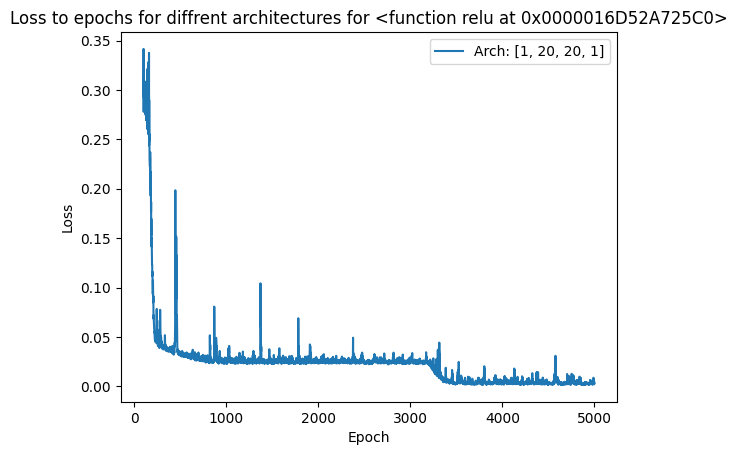

In [10]:
fr = 100
to = 10000
for arch in archs:
    y = results_df[pd.concat([results_df["Patience"].apply(lambda x: x==0),results_df["Dropout"].apply(lambda x: x==0), results_df["Fun"].apply(lambda x: x==relu)], axis=1).all(axis=1)].reset_index()["Train_results"][0]
    plt.plot(np.arange(len(y[fr:to])) + fr, y[fr:to], label = f"Arch: {arch}")
plt.legend()
plt.title(f"Loss to epochs for diffrent architectures for {relu}")
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.show()


DLA ZBIORU TESTOWEGO


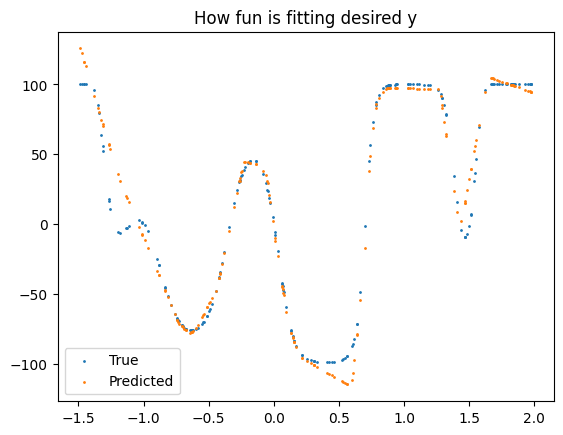

In [11]:
print("\nDLA ZBIORU TESTOWEGO")
eval_2d(results_df.iloc[0]["Net"], x_test, y_test)

### Testy2

Uwagi:
- Zwiększyłem też batch_size dla szybszego uczenia do testów
- Dropout nie działa dobrze (więc go już nie testuje ze względu na czas)
- Tutaj testuję też regularyzację

In [12]:
np.random.seed(123)
archs = [[1, 20, 20, 1]]
funs = [sigmoid, tanh, relu, leaky_relu]
fun_derivs = [sigmoid_deriv, tanh_deriv, relu_deriv, leaky_relu_deriv]
dropouts = [0] # Testy dropout'u usunąłem
early_stops = [0, 50, 100, 200, 500]  # Patience = 1 jest za mały tak samo = 5 oraz 10 i 20, więc usunąłem
l1_vals = [0, 0.01, 0.001, 0.0001]
l2_vals = [0, 0.01, 0.001, 0.0001]
initialization = ["xavier", "xavier", "he", "he"]
results = { "Arch": [],
            "Fun": [],
            "Test_loss": [],
            "Train_results": [], 
            "Dropout": [],
            "Patience": [],
            "Net": [],
            "L1": [],
            "L2": [],}

for arch in archs:
    for i in range(len(funs)):
        for dropout in dropouts:
            for early_stop in early_stops:
                for l1 in l1_vals:
                    for l2 in l2_vals:
                        net = MLP(arch, act_fun=funs[i], act_derivative=fun_derivs[i], out_fun=linear, out_derivative=linear_deriv, init_type=initialization[i], dropout_rate=dropout)
                        curr_result = net.train(x = x_train, y = y_train, epochs = 10000, optimizer=Adam(), batch_size=None, early_stopping_patience=early_stop, val_x=x_test, val_y=y_test, l1_lambda=l1, l2_lambda=l2)
                        y_pred = net.predict(x_test)
                        test_loss = mse(y_pred, y_test)
                        results["Arch"].append(arch)
                        results["Fun"].append(funs[i])
                        results["Test_loss"].append(test_loss)
                        results["Train_results"].append(curr_result)
                        results["Dropout"].append(dropout)
                        results["Patience"].append(early_stop)
                        results["Net"].append(net)
                        results["L1"].append(l1)
                        results["L2"].append(l2)

Epoch: 1, Loss (standarized): 1.022888334421633
Epoch: 2501, Loss (standarized): 0.0013440736561702992
Epoch: 5001, Loss (standarized): 0.0010751953155939233
Epoch: 7501, Loss (standarized): 0.0014465010062810102
Final epoch: 10000, Final loss (standarized): 0.00012286698006807933
Epoch: 1, Loss (standarized): 1.6733097576974856
Epoch: 2501, Loss (standarized): 0.6897154781525361
Epoch: 5001, Loss (standarized): 0.6900185168817973
Epoch: 7501, Loss (standarized): 0.6899529196236059
Final epoch: 10000, Final loss (standarized): 0.6898357689464992
Epoch: 1, Loss (standarized): 1.0161420549694955
Epoch: 2501, Loss (standarized): 0.08717720270721155
Epoch: 5001, Loss (standarized): 0.08661214664371691
Epoch: 7501, Loss (standarized): 0.08599622637498641
Final epoch: 10000, Final loss (standarized): 0.08540688839373337
Epoch: 1, Loss (standarized): 1.3415494457826367
Epoch: 2501, Loss (standarized): 0.038059892174486576
Epoch: 5001, Loss (standarized): 0.03710413934638994
Epoch: 7501, Loss 

In [13]:
results_df = pd.DataFrame(results).sort_values("Test_loss")

In [14]:
results_df[:10]

,Arch,Fun,Test_loss,Train_results,Dropout,Patience,Net,L1,L2
80,"[1, 20, 20, 1]",<function tanh at 0x0000016D52A15A80>,67.614738,"[0.9294947454919453, 0.8650905675482763, 0.892...",0,0,<__main__.MLP object at 0x0000016D54DCB770>,0.0000,0.0000
48,"[1, 20, 20, 1]",<function sigmoid at 0x0000016D52F780E0>,85.259411,"[1.8294399670385342, 1.458842082664945, 1.2025...",0,200,<__main__.MLP object at 0x0000016D580D06B0>,0.0000,0.0000
92,"[1, 20, 20, 1]",<function tanh at 0x0000016D52A15A80>,88.063898,"[1.2545178777477692, 0.9858463519498022, 0.839...",0,0,<__main__.MLP object at 0x0000016D580D28D0>,0.0001,0.0000
124,"[1, 20, 20, 1]",<function tanh at 0x0000016D52A15A80>,101.784085,"[1.187609965057454, 0.9516584605215115, 0.8260...",0,100,<__main__.MLP object at 0x0000016D54DC86B0>,0.0001,0.0000
12,"[1, 20, 20, 1]",<function sigmoid at 0x0000016D52F780E0>,105.696081,"[0.9996778486920015, 1.0140833164612744, 0.986...",0,0,<__main__.MLP object at 0x0000016D54B7EA20>,0.0001,0.0000
96,"[1, 20, 20, 1]",<function tanh at 0x0000016D52A15A80>,113.013384,"[1.510079335358738, 1.1517742456273732, 0.9234...",0,50,<__main__.MLP object at 0x0000016D54DC9640>,0.0000,0.0000
143,"[1, 20, 20, 1]",<function tanh at 0x0000016D52A15A80>,114.662063,"[0.831903573725836, 0.8254574929538814, 0.8171...",0,200,<__main__.MLP object at 0x0000016D54DCA360>,0.0001,0.0001
0,"[1, 20, 20, 1]",<function sigmoid at 0x0000016D52F780E0>,115.274965,"[1.022888334421633, 1.002292723396543, 0.98332...",0,0,<__main__.MLP object at 0x0000016D54C893D0>,0.0000,0.0000
156,"[1, 20, 20, 1]",<function tanh at 0x0000016D52A15A80>,115.965850,"[1.2502262577022407, 1.030998771542686, 0.8905...",0,500,<__main__.MLP object at 0x0000016D580D2E70>,0.0001,0.0000
95,"[1, 20, 20, 1]",<function tanh at 0x0000016D52A15A80>,122.204717,"[1.066663504601318, 0.878163244094605, 0.81382...",0,0,<__main__.MLP object at 0x0000016D54BD5D60>,0.0001,0.0001


In [15]:
results_df[-10:]

,Arch,Fun,Test_loss,Train_results,Dropout,Patience,Net,L1,L2
53,"[1, 20, 20, 1]",<function sigmoid at 0x0000016D52F780E0>,5442.537824,"[2.2396294012253994, 1.8058878680027441, 1.476...",0,200,<__main__.MLP object at 0x0000016D580D2630>,0.01,0.0100
55,"[1, 20, 20, 1]",<function sigmoid at 0x0000016D52F780E0>,5444.190890,"[0.9856084534508882, 0.9846967733031589, 0.980...",0,200,<__main__.MLP object at 0x0000016D580D2000>,0.01,0.0001
69,"[1, 20, 20, 1]",<function sigmoid at 0x0000016D52F780E0>,5444.225040,"[2.5502655028616132, 2.071749957962561, 1.6980...",0,500,<__main__.MLP object at 0x0000016D54DCBF80>,0.01,0.0100
5,"[1, 20, 20, 1]",<function sigmoid at 0x0000016D52F780E0>,5444.566805,"[1.004990875496167, 0.9971347867942313, 0.9989...",0,0,<__main__.MLP object at 0x0000016D54B57D40>,0.01,0.0100
54,"[1, 20, 20, 1]",<function sigmoid at 0x0000016D52F780E0>,5447.077613,"[1.1134479865716158, 1.0244709509866248, 0.990...",0,200,<__main__.MLP object at 0x0000016D580D3A40>,0.01,0.0010
21,"[1, 20, 20, 1]",<function sigmoid at 0x0000016D52F780E0>,5447.440157,"[1.0841016145145042, 1.0165795112791867, 1.008...",0,50,<__main__.MLP object at 0x0000016D580EEA80>,0.01,0.0100
36,"[1, 20, 20, 1]",<function sigmoid at 0x0000016D52F780E0>,5450.529752,"[1.8215639939784851, 1.4414333340514958, 1.182...",0,100,<__main__.MLP object at 0x0000016D580D3770>,0.01,0.0000
37,"[1, 20, 20, 1]",<function sigmoid at 0x0000016D52F780E0>,5451.159920,"[2.0310069541166333, 1.5844083647536027, 1.272...",0,100,<__main__.MLP object at 0x0000016D580D0BC0>,0.01,0.0100
52,"[1, 20, 20, 1]",<function sigmoid at 0x0000016D52F780E0>,5453.431527,"[2.112553235628583, 1.6700673878469963, 1.3453...",0,200,<__main__.MLP object at 0x0000016D580D27E0>,0.01,0.0000
39,"[1, 20, 20, 1]",<function sigmoid at 0x0000016D52F780E0>,5461.364614,"[1.831622058412713, 1.5353938475901228, 1.3111...",0,100,<__main__.MLP object at 0x0000016D580D3830>,0.01,0.0001


## Dane rings5-sparse

### Pobranie

In [5]:
# Pobieramy dane
data_train = pd.read_csv("../Data/classification/rings5-sparse-training.csv").to_numpy()
x_train = data_train[:, 0:2].reshape(-1, 2)
y_train = one_hot(np.int64(data_train[:, 2]))

data_test = pd.read_csv("../Data/classification/rings5-sparse-test.csv").to_numpy()
x_test = data_test[:, 0:2].reshape(-1, 2)
y_test = one_hot(np.int64(data_test[:, 2]))

In [7]:
data_train.shape

(200, 3)

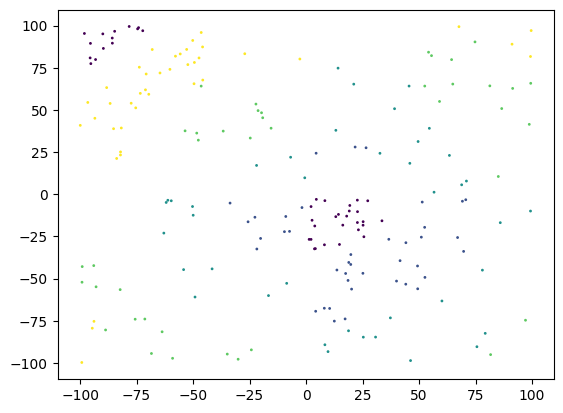

In [8]:
plt.scatter(x_train[:, 0], x_train[:, 1], c = data_train[:, 2], s = 1)
plt.show()

### Testy

In [9]:
np.random.seed(123)
archs = [[2, 20, 20, 5]]
funs = [sigmoid, tanh, relu, leaky_relu]
fun_derivs = [sigmoid_deriv, tanh_deriv, relu_deriv, leaky_relu_deriv]
dropouts = [0] # Testy dropout'u usunąłem
early_stops = [0, 50, 100, 200, 500]  # Patience = 1 jest za mały tak samo = 5 oraz 10 i 20, więc usunąłem
l1_vals = [0, 0.01, 0.001, 0.0001]
l2_vals = [0, 0.01, 0.001, 0.0001]
initialization = ["xavier", "xavier", "he", "he"]
results = { "Arch": [],
            "Fun": [],
            "Train_results": [], 
            "Dropout": [],
            "Patience": [],
            "Net": [],
            "L1": [],
            "L2": [],
            "Fscore": []}

for arch in archs:
    for i in range(len(funs)):
        for dropout in dropouts:
            for early_stop in early_stops:
                for l1 in l1_vals:
                    for l2 in l2_vals:
                        net = MLP(arch, act_fun=funs[i], act_derivative=fun_derivs[i], out_fun=softmax, out_derivative=linear_deriv, init_type=initialization[i], dropout_rate=dropout)
                        curr_result = net.train_classify(x = x_train, y = y_train, loss_fun=cross_entropy, epochs = 2000, optimizer=Adam(), batch_size=None, early_stopping_patience=early_stop, val_x=x_test, val_y=y_test, l1_lambda=l1, l2_lambda=l2)
                        y_pred = net.predict(x_test)
                        y_pred = from_one_hot_to_label(one_hot_from_probabilities(y_pred))
                        fscore = f1_score(from_one_hot_to_label(y_test), y_pred)
                        results["Arch"].append(arch)
                        results["Fun"].append(funs[i])
                        results["Fscore"].append(fscore)
                        results["Train_results"].append(curr_result)
                        results["Dropout"].append(dropout)
                        results["Patience"].append(early_stop)
                        results["Net"].append(net)
                        results["L1"].append(l1)
                        results["L2"].append(l2)

Epoch: 1, Loss (standarized): 1.673852457674859
Epoch: 501, Loss (standarized): 0.15994032594067284
Epoch: 1001, Loss (standarized): 0.04386897911723281
Epoch: 1501, Loss (standarized): 0.011078020851699613
Final epoch: 2000, Final loss (standarized): 0.003169569138707469
Epoch: 1, Loss (standarized): 1.6478525715123578
Epoch: 501, Loss (standarized): 1.3665921329589283
Epoch: 1001, Loss (standarized): 1.3664575461336284
Epoch: 1501, Loss (standarized): 1.3664108167308007
Final epoch: 2000, Final loss (standarized): 1.3664096793361766
Epoch: 1, Loss (standarized): 1.8999089146878487
Epoch: 501, Loss (standarized): 0.40106998711416525
Epoch: 1001, Loss (standarized): 0.3173359541104403
Epoch: 1501, Loss (standarized): 0.27181153922714035
Final epoch: 2000, Final loss (standarized): 0.25421615149713894
Epoch: 1, Loss (standarized): 1.6706407933269094
Epoch: 501, Loss (standarized): 0.22584961616367147
Epoch: 1001, Loss (standarized): 0.07179622551717688
Epoch: 1501, Loss (standarized): 0

In [10]:
results_df = pd.DataFrame(results).sort_values("Fscore")
results_df[:10]

,Arch,Fun,Train_results,Dropout,Patience,Net,L1,L2,Fscore
54,"[2, 20, 20, 5]",<function sigmoid at 0x00000138AE6C0900>,"[1.8706668110152942, 1.8151030512749668, 1.769...",0,200,<__main__.MLP object at 0x00000138B037A930>,0.01,0.0010,0.018503
23,"[2, 20, 20, 5]",<function sigmoid at 0x00000138AE6C0900>,"[1.8281549088873814, 1.7569768088214233, 1.705...",0,50,<__main__.MLP object at 0x00000138B031DA90>,0.01,0.0001,0.018503
52,"[2, 20, 20, 5]",<function sigmoid at 0x00000138AE6C0900>,"[2.0323760062847858, 1.9029585603890298, 1.803...",0,200,<__main__.MLP object at 0x00000138AE4D2510>,0.01,0.0000,0.018503
53,"[2, 20, 20, 5]",<function sigmoid at 0x00000138AE6C0900>,"[1.6447362008462323, 1.625651434937455, 1.6147...",0,200,<__main__.MLP object at 0x00000138B037A870>,0.01,0.0100,0.018503
70,"[2, 20, 20, 5]",<function sigmoid at 0x00000138AE6C0900>,"[1.646821914019332, 1.6234766683001791, 1.6106...",0,500,<__main__.MLP object at 0x00000138AD4C3D40>,0.01,0.0010,0.018503
38,"[2, 20, 20, 5]",<function sigmoid at 0x00000138AE6C0900>,"[1.8224394648426536, 1.7541530518498476, 1.703...",0,100,<__main__.MLP object at 0x00000138B010A5D0>,0.01,0.0010,0.041898
4,"[2, 20, 20, 5]",<function sigmoid at 0x00000138AE6C0900>,"[1.791583064072538, 1.7495289203970776, 1.7128...",0,0,<__main__.MLP object at 0x00000138B0333A70>,0.01,0.0000,0.041898
22,"[2, 20, 20, 5]",<function sigmoid at 0x00000138AE6C0900>,"[1.9625563076641805, 1.8604765466587885, 1.776...",0,50,<__main__.MLP object at 0x00000138B031DAC0>,0.01,0.0010,0.041898
37,"[2, 20, 20, 5]",<function sigmoid at 0x00000138AE6C0900>,"[1.6755573470275302, 1.644507733630841, 1.6271...",0,100,<__main__.MLP object at 0x00000138AE4D09E0>,0.01,0.0100,0.041898
68,"[2, 20, 20, 5]",<function sigmoid at 0x00000138AE6C0900>,"[1.695547388827245, 1.660451242436008, 1.63944...",0,500,<__main__.MLP object at 0x00000138B03DBB90>,0.01,0.0000,0.053229


In [11]:
results_df[-10:]

,Arch,Fun,Train_results,Dropout,Patience,Net,L1,L2,Fscore
219,"[2, 20, 20, 5]",<function relu at 0x00000138AE47A8E0>,"[2.6679942310000753, 2.386076606136367, 2.1618...",0,200,<__main__.MLP object at 0x00000138B0457DA0>,0.0010,0.0001,0.842862
299,"[2, 20, 20, 5]",<function leaky_relu at 0x00000138AE191620>,"[2.235708064460594, 1.9839879238969151, 1.7977...",0,200,<__main__.MLP object at 0x00000138AE692AE0>,0.0010,0.0001,0.843036
251,"[2, 20, 20, 5]",<function leaky_relu at 0x00000138AE191620>,"[2.488004247776605, 2.186712234011412, 1.94950...",0,0,<__main__.MLP object at 0x00000138B0411D60>,0.0010,0.0001,0.843820
315,"[2, 20, 20, 5]",<function leaky_relu at 0x00000138AE191620>,"[2.5491790320559526, 2.187725427607646, 1.9104...",0,500,<__main__.MLP object at 0x00000138B04A9BB0>,0.0010,0.0001,0.844642
288,"[2, 20, 20, 5]",<function leaky_relu at 0x00000138AE191620>,"[2.0083938129236083, 1.8729777051652803, 1.765...",0,200,<__main__.MLP object at 0x00000138B04A83B0>,0.0000,0.0000,0.846231
296,"[2, 20, 20, 5]",<function leaky_relu at 0x00000138AE191620>,"[2.1975600587144912, 1.9712520436986518, 1.788...",0,200,<__main__.MLP object at 0x00000138B0413710>,0.0010,0.0000,0.847221
56,"[2, 20, 20, 5]",<function sigmoid at 0x00000138AE6C0900>,"[1.971636556298523, 1.8523977368220514, 1.7599...",0,200,<__main__.MLP object at 0x00000138B03DAA50>,0.0010,0.0000,0.848399
48,"[2, 20, 20, 5]",<function sigmoid at 0x00000138AE6C0900>,"[1.8157414891644041, 1.7372358467093085, 1.683...",0,200,<__main__.MLP object at 0x00000138B037A510>,0.0000,0.0000,0.851560
79,"[2, 20, 20, 5]",<function sigmoid at 0x00000138AE6C0900>,"[1.7798213769182911, 1.6931736460163105, 1.641...",0,500,<__main__.MLP object at 0x00000138B037C710>,0.0001,0.0001,0.854622
176,"[2, 20, 20, 5]",<function relu at 0x00000138AE47A8E0>,"[2.071378176489713, 1.8074366530473152, 1.6270...",0,50,<__main__.MLP object at 0x00000138B0410B30>,0.0000,0.0000,0.858219


## Dane rings3-balance

### Pobranie

In [12]:
# Pobieramy dane
data_train = pd.read_csv("../Data/classification/rings3-balance-training.csv").to_numpy()
x_train = data_train[:, 0:2].reshape(-1, 2)
y_train = one_hot(np.int64(data_train[:, 2]))

data_test = pd.read_csv("../Data/classification/rings3-balance-test.csv").to_numpy()
x_test = data_test[:, 0:2].reshape(-1, 2)
y_test = one_hot(np.int64(data_test[:, 2]))

In [13]:
data_train

array([[-51.44441002,  96.40676617,   0.        ],
       [ 35.5127634 ,  11.8805334 ,   0.        ],
       [  3.50474045,  16.61240323,   0.        ],
       ...,
       [ 52.08190489, -85.68621627,   2.        ],
       [-21.63032037,  61.7781024 ,   2.        ],
       [-21.77091497,  77.73783407,   2.        ]])

In [14]:
data_train.shape

(2060, 3)

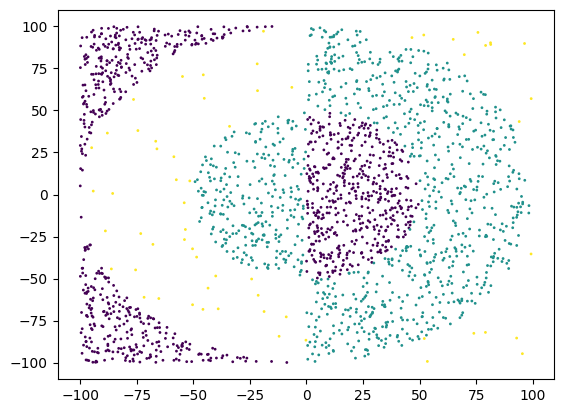

In [15]:
plt.scatter(x_train[:, 0], x_train[:, 1], c = data_train[:, 2], s = 1)
plt.show()

### Testy

In [16]:
np.random.seed(123)
archs = [[2, 20, 20, 3]]
funs = [sigmoid, tanh, relu, leaky_relu]
fun_derivs = [sigmoid_deriv, tanh_deriv, relu_deriv, leaky_relu_deriv]
dropouts = [0] # Testy dropout'u usunąłem
early_stops = [0, 50, 100, 200, 500]  # Patience = 1 jest za mały tak samo = 5 oraz 10 i 20, więc usunąłem
l1_vals = [0, 0.01, 0.001, 0.0001]
l2_vals = [0, 0.01, 0.001, 0.0001]
initialization = ["xavier", "xavier", "he", "he"]
results = { "Arch": [],
            "Fun": [],
            "Fscore": [],
            "Train_results": [], 
            "Dropout": [],
            "Patience": [],
            "Net": [],
            "L1": [],
            "L2": [],}

for arch in archs:
    for i in range(len(funs)):
        for dropout in dropouts:
            for early_stop in early_stops:
                for l1 in l1_vals:
                    for l2 in l2_vals:
                        net = MLP(arch, act_fun=funs[i], act_derivative=fun_derivs[i], out_fun=softmax, out_derivative=linear_deriv, init_type=initialization[i], dropout_rate=dropout)
                        curr_result = net.train_classify(x = x_train, y = y_train, loss_fun=cross_entropy, epochs = 2000, optimizer=Adam(), batch_size=None, early_stopping_patience=early_stop, val_x=x_test, val_y=y_test, l1_lambda=l1, l2_lambda=l2)
                        y_pred = net.predict(x_test)
                        y_pred = from_one_hot_to_label(one_hot_from_probabilities(y_pred))
                        fscore = f1_score(from_one_hot_to_label(y_test), y_pred)
                        results["Arch"].append(arch)
                        results["Fun"].append(funs[i])
                        results["Fscore"].append(fscore)
                        results["Train_results"].append(curr_result)
                        results["Dropout"].append(dropout)
                        results["Patience"].append(early_stop)
                        results["Net"].append(net)
                        results["L1"].append(l1)
                        results["L2"].append(l2)

Epoch: 1, Loss (standarized): 1.0251299204145154
Epoch: 501, Loss (standarized): 0.17225804704364273
Epoch: 1001, Loss (standarized): 0.04087556737573167
Epoch: 1501, Loss (standarized): 0.017584997192851025
Final epoch: 2000, Final loss (standarized): 0.010201893220423584
Epoch: 1, Loss (standarized): 1.1727835678123926
Epoch: 501, Loss (standarized): 0.656749711930937
Epoch: 1001, Loss (standarized): 0.656503726538989
Epoch: 1501, Loss (standarized): 0.6564739363492353
Final epoch: 2000, Final loss (standarized): 0.6564867073037898
Epoch: 1, Loss (standarized): 1.1312977643847233
Epoch: 501, Loss (standarized): 0.6411123947010395
Epoch: 1001, Loss (standarized): 0.2067787454175463
Epoch: 1501, Loss (standarized): 0.1824115389663181
Final epoch: 2000, Final loss (standarized): 0.17841485756474806
Epoch: 1, Loss (standarized): 1.0633625719515034
Epoch: 501, Loss (standarized): 0.16057408671431764
Epoch: 1001, Loss (standarized): 0.06610794460069098
Epoch: 1501, Loss (standarized): 0.04

In [17]:
results_df = pd.DataFrame(results).sort_values("Fscore")
results_df[:10]

,Arch,Fun,Fscore,Train_results,Dropout,Patience,Net,L1,L2
55,"[2, 20, 20, 3]",<function sigmoid at 0x00000138AE6C0900>,0.117065,"[1.433064563656343, 1.2873575661656096, 1.1626...",0,200,<__main__.MLP object at 0x00000138B031DA60>,0.01,0.0001
39,"[2, 20, 20, 3]",<function sigmoid at 0x00000138AE6C0900>,0.117065,"[1.8390083263094836, 1.5836208732556973, 1.375...",0,100,<__main__.MLP object at 0x00000138B0455EE0>,0.01,0.0001
6,"[2, 20, 20, 3]",<function sigmoid at 0x00000138AE6C0900>,0.117065,"[1.8908188706930877, 1.7382083863463453, 1.600...",0,0,<__main__.MLP object at 0x00000138B04A90D0>,0.01,0.0010
37,"[2, 20, 20, 3]",<function sigmoid at 0x00000138AE6C0900>,0.117065,"[1.5591649708736532, 1.3801637063339929, 1.236...",0,100,<__main__.MLP object at 0x00000138B031CB60>,0.01,0.0100
71,"[2, 20, 20, 3]",<function sigmoid at 0x00000138AE6C0900>,0.117065,"[1.4147908943003298, 1.2583002998244088, 1.139...",0,500,<__main__.MLP object at 0x00000138B037BC80>,0.01,0.0001
53,"[2, 20, 20, 3]",<function sigmoid at 0x00000138AE6C0900>,0.117065,"[0.9337364655043991, 0.8994279041316854, 0.872...",0,200,<__main__.MLP object at 0x00000138B0456ED0>,0.01,0.0100
52,"[2, 20, 20, 3]",<function sigmoid at 0x00000138AE6C0900>,0.117065,"[1.7566609526313377, 1.5701481979468874, 1.413...",0,200,<__main__.MLP object at 0x00000138B0476C30>,0.01,0.0000
22,"[2, 20, 20, 3]",<function sigmoid at 0x00000138AE6C0900>,0.117065,"[1.2531172996939859, 1.1285129551248945, 1.023...",0,50,<__main__.MLP object at 0x00000138B04CA3C0>,0.01,0.0010
20,"[2, 20, 20, 3]",<function sigmoid at 0x00000138AE6C0900>,0.117065,"[0.9093607188554614, 0.8666643245972405, 0.839...",0,50,<__main__.MLP object at 0x00000138B02F36B0>,0.01,0.0000
68,"[2, 20, 20, 3]",<function sigmoid at 0x00000138AE6C0900>,0.190986,"[1.008741450424607, 0.9423076847159066, 0.8939...",0,500,<__main__.MLP object at 0x00000138AFDCFC20>,0.01,0.0000


In [18]:
results_df[-10:]

,Arch,Fun,Fscore,Train_results,Dropout,Patience,Net,L1,L2
92,"[2, 20, 20, 3]",<function tanh at 0x00000138AE47B6A0>,0.914554,"[1.3115078298986893, 1.1174502347524609, 0.975...",0,0,<__main__.MLP object at 0x00000138B04CB590>,0.0001,0.0
188,"[2, 20, 20, 3]",<function relu at 0x00000138AE47A8E0>,0.916002,"[1.1562958731272759, 0.9819417879417415, 0.860...",0,50,<__main__.MLP object at 0x00000138B04CB6B0>,0.0001,0.0
48,"[2, 20, 20, 3]",<function sigmoid at 0x00000138AE6C0900>,0.916742,"[0.8681111916270362, 0.8325478584184427, 0.809...",0,200,<__main__.MLP object at 0x00000138B0476690>,0.0000,0.0
272,"[2, 20, 20, 3]",<function leaky_relu at 0x00000138AE191620>,0.919354,"[1.2321472054150149, 1.0279916812709726, 0.904...",0,100,<__main__.MLP object at 0x00000138B04CADE0>,0.0000,0.0
80,"[2, 20, 20, 3]",<function tanh at 0x00000138AE47B6A0>,0.921156,"[1.3072927801767598, 1.1280431582642703, 0.990...",0,0,<__main__.MLP object at 0x00000138B031F260>,0.0000,0.0
112,"[2, 20, 20, 3]",<function tanh at 0x00000138AE47B6A0>,0.921839,"[1.1823691208175438, 1.0295823674787852, 0.918...",0,100,<__main__.MLP object at 0x00000138B0412D50>,0.0000,0.0
208,"[2, 20, 20, 3]",<function relu at 0x00000138AE47A8E0>,0.923190,"[1.3645986774540768, 1.1247170783410068, 0.969...",0,200,<__main__.MLP object at 0x00000138B04F7410>,0.0000,0.0
256,"[2, 20, 20, 3]",<function leaky_relu at 0x00000138AE191620>,0.925993,"[2.2142171083386946, 1.796681933865188, 1.4890...",0,50,<__main__.MLP object at 0x00000138B0539DF0>,0.0000,0.0
192,"[2, 20, 20, 3]",<function relu at 0x00000138AE47A8E0>,0.927464,"[2.56609850085045, 2.127205435439452, 1.760373...",0,100,<__main__.MLP object at 0x00000138B053B9B0>,0.0000,0.0
96,"[2, 20, 20, 3]",<function tanh at 0x00000138AE47B6A0>,0.928748,"[1.0639245197586946, 0.9552036653705219, 0.884...",0,50,<__main__.MLP object at 0x00000138B04A9790>,0.0000,0.0


## Dane xor3-balance 

### Pobranie

In [19]:
# Pobieramy dane
data_train = pd.read_csv("../Data/classification/xor3-balance-training.csv").to_numpy()
x_train = data_train[:, 0:2].reshape(-1, 2)
y_train = one_hot(np.int64(data_train[:, 2]))

data_test = pd.read_csv("../Data/classification/xor3-balance-test.csv").to_numpy()
x_test = data_test[:, 0:2].reshape(-1, 2)
y_test = one_hot(np.int64(data_test[:, 2]))

In [20]:
data_train

array([[-86.23096328, -45.01857441,   0.        ],
       [ 60.88322946,  50.77961916,   0.        ],
       [ -8.72861184,   5.85191385,   0.        ],
       ...,
       [ 17.16453284,  89.25944283,   1.        ],
       [ 22.12683172, -51.50079206,   1.        ],
       [-60.08537863,  -8.76080655,   1.        ]])

In [21]:
data_train.shape

(1050, 3)

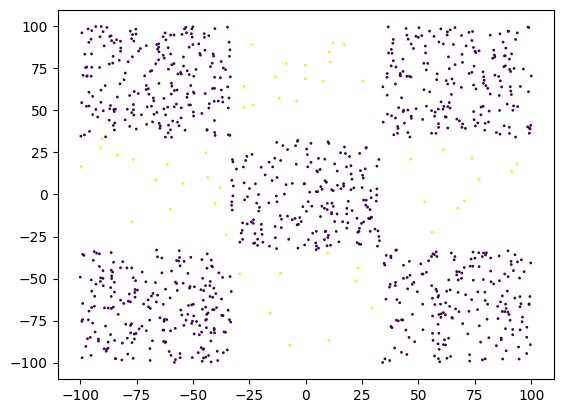

In [22]:
plt.scatter(x_train[:, 0], x_train[:, 1], c = data_train[:, 2], s = 1)
plt.show()

### Testy

In [23]:
np.random.seed(123)
archs = [[2, 20, 20, 2]]
funs = [sigmoid, tanh, relu, leaky_relu]
fun_derivs = [sigmoid_deriv, tanh_deriv, relu_deriv, leaky_relu_deriv]
dropouts = [0] # Testy dropout'u usunąłem
early_stops = [0, 50, 100, 200, 500]  # Patience = 1 jest za mały tak samo = 5 oraz 10 i 20, więc usunąłem
l1_vals = [0, 0.01, 0.001, 0.0001]
l2_vals = [0, 0.01, 0.001, 0.0001]
initialization = ["xavier", "xavier", "he", "he"]
results = { "Arch": [],
            "Fun": [],
            "Fscore": [],
            "Train_results": [], 
            "Dropout": [],
            "Patience": [],
            "Net": [],
            "L1": [],
            "L2": [],}

for arch in archs:
    for i in range(len(funs)):
        for dropout in dropouts:
            for early_stop in early_stops:
                for l1 in l1_vals:
                    for l2 in l2_vals:
                        net = MLP(arch, act_fun=funs[i], act_derivative=fun_derivs[i], out_fun=softmax, out_derivative=linear_deriv, init_type=initialization[i], dropout_rate=dropout)
                        curr_result = net.train_classify(x = x_train, y = y_train, loss_fun=cross_entropy, epochs = 2000, optimizer=Adam(), batch_size=None, early_stopping_patience=early_stop, val_x=x_test, val_y=y_test, l1_lambda=l1, l2_lambda=l2)
                        y_pred = net.predict(x_test)
                        y_pred = from_one_hot_to_label(one_hot_from_probabilities(y_pred))
                        fscore = f1_score(from_one_hot_to_label(y_test), y_pred)
                        results["Arch"].append(arch)
                        results["Fun"].append(funs[i])
                        results["Fscore"].append(fscore)
                        results["Train_results"].append(curr_result)
                        results["Dropout"].append(dropout)
                        results["Patience"].append(early_stop)
                        results["Net"].append(net)
                        results["L1"].append(l1)
                        results["L2"].append(l2)

Epoch: 1, Loss (standarized): 0.9990982381917314
Epoch: 501, Loss (standarized): 0.16357186206021845
Epoch: 1001, Loss (standarized): 0.0907948064798447
Epoch: 1501, Loss (standarized): 0.01203625600877597
Final epoch: 2000, Final loss (standarized): 0.003360811837484921
Epoch: 1, Loss (standarized): 0.722251324460041
Epoch: 501, Loss (standarized): 0.1914739444096058
Epoch: 1001, Loss (standarized): 0.19145651070966763
Epoch: 1501, Loss (standarized): 0.1914487893523547
Final epoch: 2000, Final loss (standarized): 0.19144555186496365
Epoch: 1, Loss (standarized): 0.339035390004662
Epoch: 501, Loss (standarized): 0.19086668936786444
Epoch: 1001, Loss (standarized): 0.1913441399473432
Epoch: 1501, Loss (standarized): 0.19143511929000379
Final epoch: 2000, Final loss (standarized): 0.19144317880578263
Epoch: 1, Loss (standarized): 0.5187611672533671
Epoch: 501, Loss (standarized): 0.184889865792147
Epoch: 1001, Loss (standarized): 0.03612051492403373
Epoch: 1501, Loss (standarized): 0.01

In [24]:
results_df = pd.DataFrame(results).sort_values("Fscore")
results_df[:10]

,Arch,Fun,Fscore,Train_results,Dropout,Patience,Net,L1,L2
122,"[2, 20, 20, 2]",<function tanh at 0x00000138AE47B6A0>,0.355878,"[0.8234936236583922, 0.7170333468621599, 0.629...",0,100,<__main__.MLP object at 0x00000138DED7D790>,0.0010,0.0010
135,"[2, 20, 20, 2]",<function tanh at 0x00000138AE47B6A0>,0.355878,"[0.6947490531617467, 0.6449245714516523, 0.600...",0,200,<__main__.MLP object at 0x00000138B04F5B50>,0.0100,0.0001
136,"[2, 20, 20, 2]",<function tanh at 0x00000138AE47B6A0>,0.355878,"[0.7990388972187605, 0.6786410532930709, 0.592...",0,200,<__main__.MLP object at 0x00000138DED7E150>,0.0010,0.0000
137,"[2, 20, 20, 2]",<function tanh at 0x00000138AE47B6A0>,0.355878,"[0.8780185797806646, 0.7186838782668643, 0.600...",0,200,<__main__.MLP object at 0x00000138DED7E2A0>,0.0010,0.0100
138,"[2, 20, 20, 2]",<function tanh at 0x00000138AE47B6A0>,0.355878,"[0.6928454880873527, 0.6372181624366834, 0.582...",0,200,<__main__.MLP object at 0x00000138B04F5EB0>,0.0010,0.0010
139,"[2, 20, 20, 2]",<function tanh at 0x00000138AE47B6A0>,0.355878,"[0.7044305338262048, 0.6526043288004971, 0.609...",0,200,<__main__.MLP object at 0x00000138B05563C0>,0.0010,0.0001
289,"[2, 20, 20, 2]",<function leaky_relu at 0x00000138AE191620>,0.355878,"[0.41447335129884916, 0.3075460119413627, 0.25...",0,200,<__main__.MLP object at 0x00000138B0475820>,0.0000,0.0100
141,"[2, 20, 20, 2]",<function tanh at 0x00000138AE47B6A0>,0.355878,"[0.6950104898377016, 0.6331604132710321, 0.561...",0,200,<__main__.MLP object at 0x00000138B05565D0>,0.0001,0.0100
285,"[2, 20, 20, 2]",<function leaky_relu at 0x00000138AE191620>,0.355878,"[0.6543722400641911, 0.4048853192890876, 0.284...",0,100,<__main__.MLP object at 0x00000138B04F55B0>,0.0001,0.0100
145,"[2, 20, 20, 2]",<function tanh at 0x00000138AE47B6A0>,0.355878,"[0.7096488906487523, 0.6490672814146482, 0.606...",0,500,<__main__.MLP object at 0x00000138B037EB10>,0.0000,0.0100


In [25]:
results_df[-10:]

,Arch,Fun,Fscore,Train_results,Dropout,Patience,Net,L1,L2
95,"[2, 20, 20, 2]",<function tanh at 0x00000138AE47B6A0>,0.910651,"[0.7042518062071215, 0.6333727132514029, 0.580...",0,0,<__main__.MLP object at 0x00000138DEDAB470>,0.0001,0.0001
268,"[2, 20, 20, 2]",<function leaky_relu at 0x00000138AE191620>,0.911817,"[0.7387761541493006, 0.5411826414528444, 0.395...",0,50,<__main__.MLP object at 0x000001389705C500>,0.0001,0.0000
316,"[2, 20, 20, 2]",<function leaky_relu at 0x00000138AE191620>,0.911817,"[0.4812454776086133, 0.32205553490667493, 0.24...",0,500,<__main__.MLP object at 0x00000138DEDCEE10>,0.0001,0.0000
256,"[2, 20, 20, 2]",<function leaky_relu at 0x00000138AE191620>,0.911817,"[1.1023565409919314, 0.8472296914727623, 0.662...",0,50,<__main__.MLP object at 0x00000138DEDABB30>,0.0000,0.0000
83,"[2, 20, 20, 2]",<function tanh at 0x00000138AE47B6A0>,0.914494,"[0.7017743782767545, 0.6512717665980078, 0.612...",0,0,<__main__.MLP object at 0x00000138B04AA7B0>,0.0000,0.0001
144,"[2, 20, 20, 2]",<function tanh at 0x00000138AE47B6A0>,0.914576,"[0.7111846493420729, 0.6453105360342696, 0.600...",0,500,<__main__.MLP object at 0x00000138B04F6360>,0.0000,0.0000
159,"[2, 20, 20, 2]",<function tanh at 0x00000138AE47B6A0>,0.915830,"[0.7503642601925733, 0.6513560180062691, 0.600...",0,500,<__main__.MLP object at 0x00000138DED7F410>,0.0001,0.0001
112,"[2, 20, 20, 2]",<function tanh at 0x00000138AE47B6A0>,0.918575,"[0.7677717044517849, 0.6503972714173772, 0.581...",0,100,<__main__.MLP object at 0x00000138B00E4B30>,0.0000,0.0000
128,"[2, 20, 20, 2]",<function tanh at 0x00000138AE47B6A0>,0.921160,"[0.8841902215483034, 0.740048053365579, 0.6315...",0,200,<__main__.MLP object at 0x00000138DED7DBE0>,0.0000,0.0000
156,"[2, 20, 20, 2]",<function tanh at 0x00000138AE47B6A0>,0.923886,"[0.7294063205176112, 0.6518896078008531, 0.596...",0,500,<__main__.MLP object at 0x00000138B0454470>,0.0001,0.0000


In [26]:
results_df.iloc[-1]["Net"].predict(x_test)

array([[9.98767070e-01, 1.23292976e-03],
       [9.99991082e-01, 8.91825854e-06],
       [2.75694143e-04, 9.99724306e-01],
       ...,
       [2.77195550e-03, 9.97228045e-01],
       [9.99889061e-01, 1.10938508e-04],
       [9.99961169e-01, 3.88313572e-05]])